<a href="https://colab.research.google.com/github/CamiloGR25/EntrenamientoAI/blob/main/Entrenamiento.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!unzip dataset_temp.zip

Archive:  dataset_temp.zip
   creating: dataset_temp/a/
  inflating: dataset_temp/a/frame_0015.jpg  
  inflating: dataset_temp/a/frame_0016.jpg  
  inflating: dataset_temp/a/frame_0017.jpg  
  inflating: dataset_temp/a/frame_0018.jpg  
  inflating: dataset_temp/a/frame_0019.jpg  
  inflating: dataset_temp/a/frame_0020.jpg  
  inflating: dataset_temp/a/frame_0021.jpg  
  inflating: dataset_temp/a/frame_0022.jpg  
  inflating: dataset_temp/a/frame_0023.jpg  
  inflating: dataset_temp/a/frame_0024.jpg  
  inflating: dataset_temp/a/frame_0025.jpg  
  inflating: dataset_temp/a/frame_0026.jpg  
  inflating: dataset_temp/a/frame_0027.jpg  
  inflating: dataset_temp/a/frame_0028.jpg  
  inflating: dataset_temp/a/frame_0029.jpg  
  inflating: dataset_temp/a/frame_0030.jpg  
  inflating: dataset_temp/a/frame_0031.jpg  
  inflating: dataset_temp/a/frame_0032.jpg  
  inflating: dataset_temp/a/frame_0033.jpg  
  inflating: dataset_temp/a/frame_0034.jpg  
  inflating: dataset_temp/a/frame_0035.jpg  

100 archivos de la carpeta w
100 archivos de la carpeta d
100 archivos de la carpeta u
100 archivos de la carpeta p
100 archivos de la carpeta x
100 archivos de la carpeta z
100 archivos de la carpeta t
100 archivos de la carpeta i
100 archivos de la carpeta c
100 archivos de la carpeta h
100 archivos de la carpeta o
100 archivos de la carpeta k
100 archivos de la carpeta n
100 archivos de la carpeta l
100 archivos de la carpeta v
100 archivos de la carpeta b
100 archivos de la carpeta y
100 archivos de la carpeta f
100 archivos de la carpeta m
100 archivos de la carpeta g


<ipython-input-1-21ebf6d06378>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15,15))


100 archivos de la carpeta eye
100 archivos de la carpeta s
100 archivos de la carpeta r
100 archivos de la carpeta e
100 archivos de la carpeta a
100 archivos de la carpeta j
100 archivos de la carpeta q
Found 2160 images belonging to 27 classes.
Found 540 images belonging to 27 classes.


<ipython-input-1-21ebf6d06378>:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2,5,i+1)


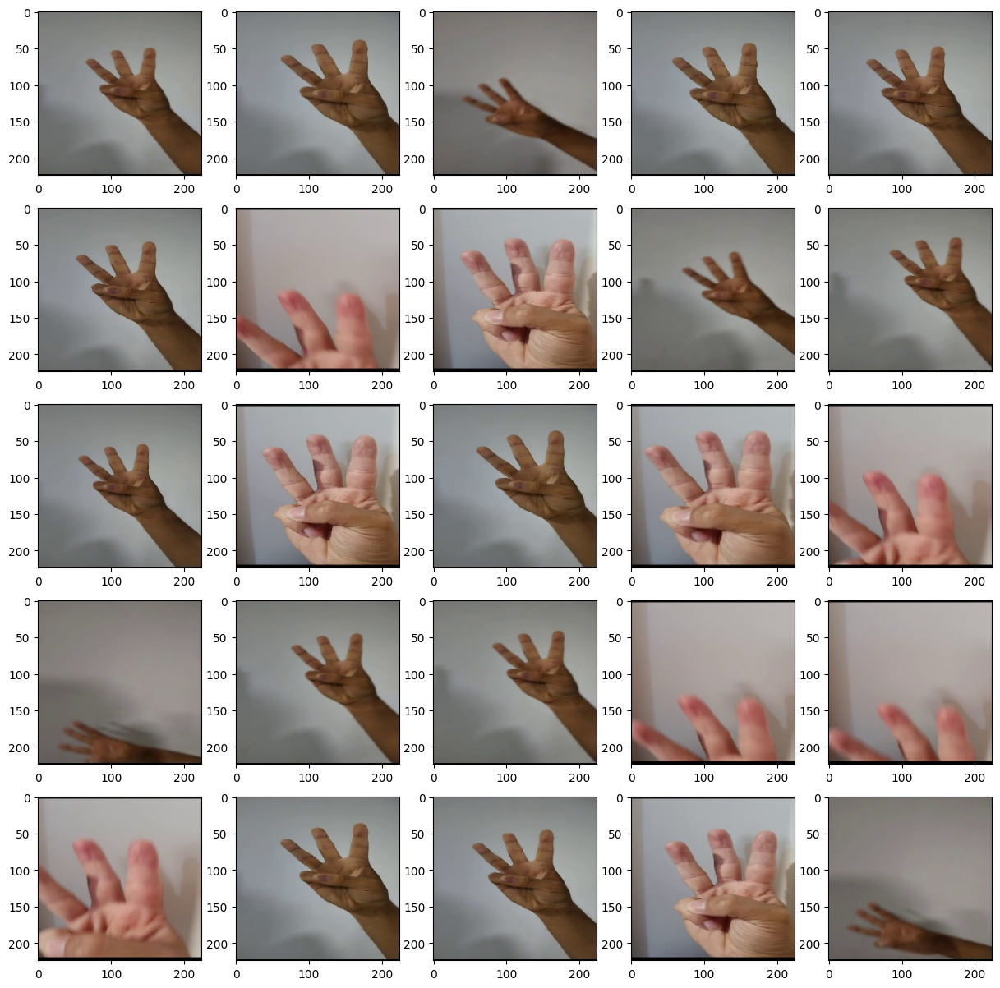

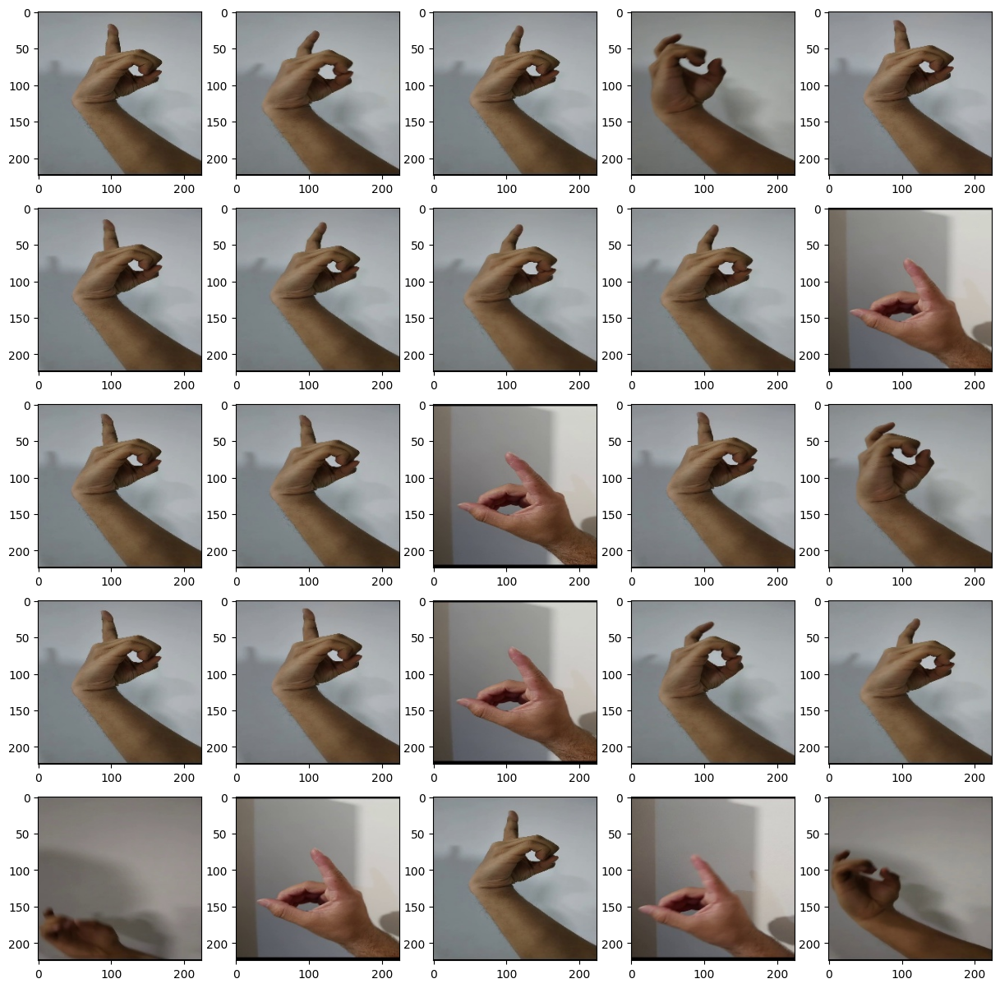

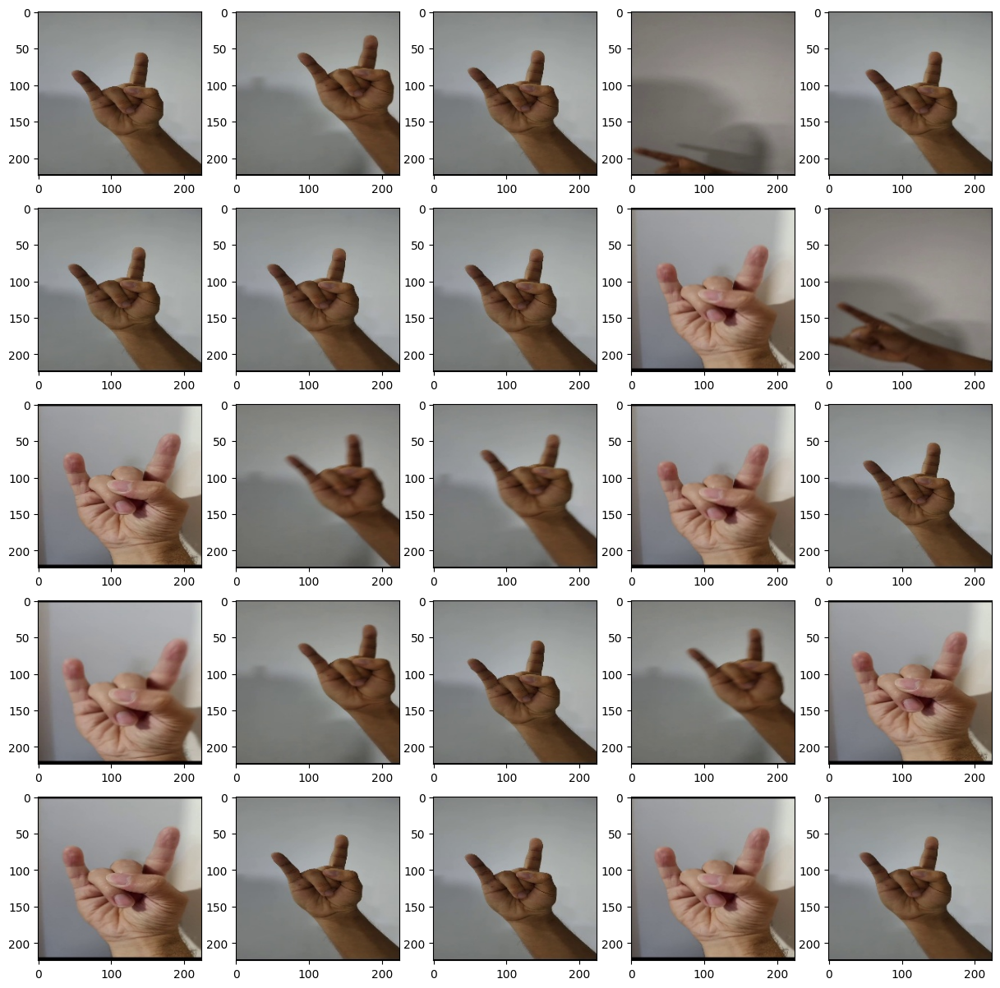

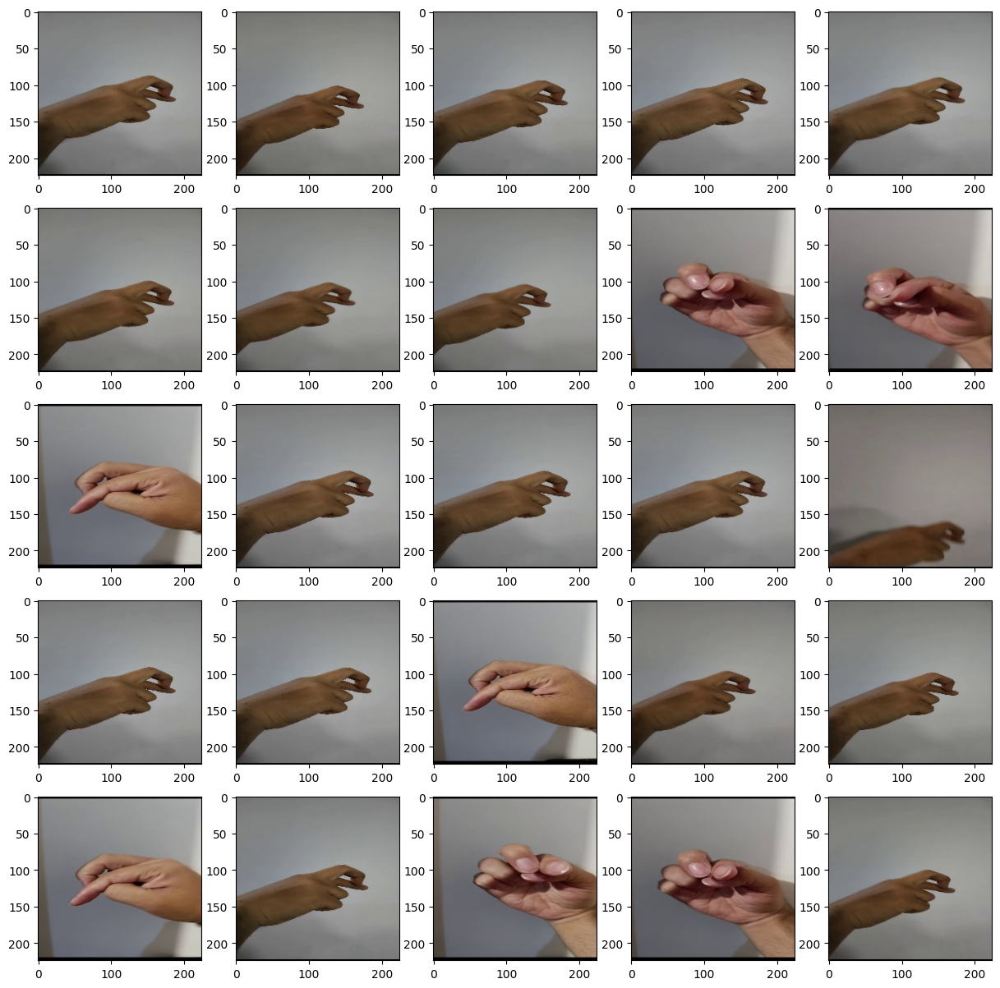

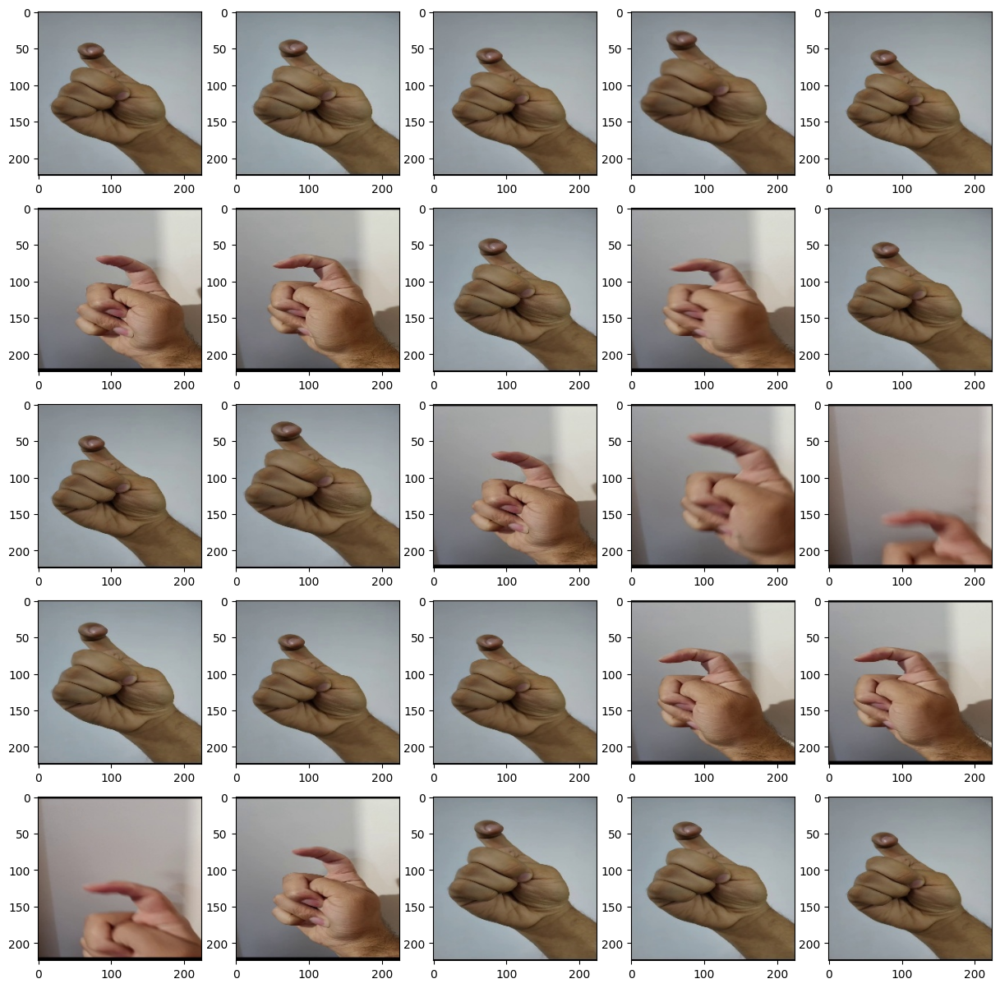

...

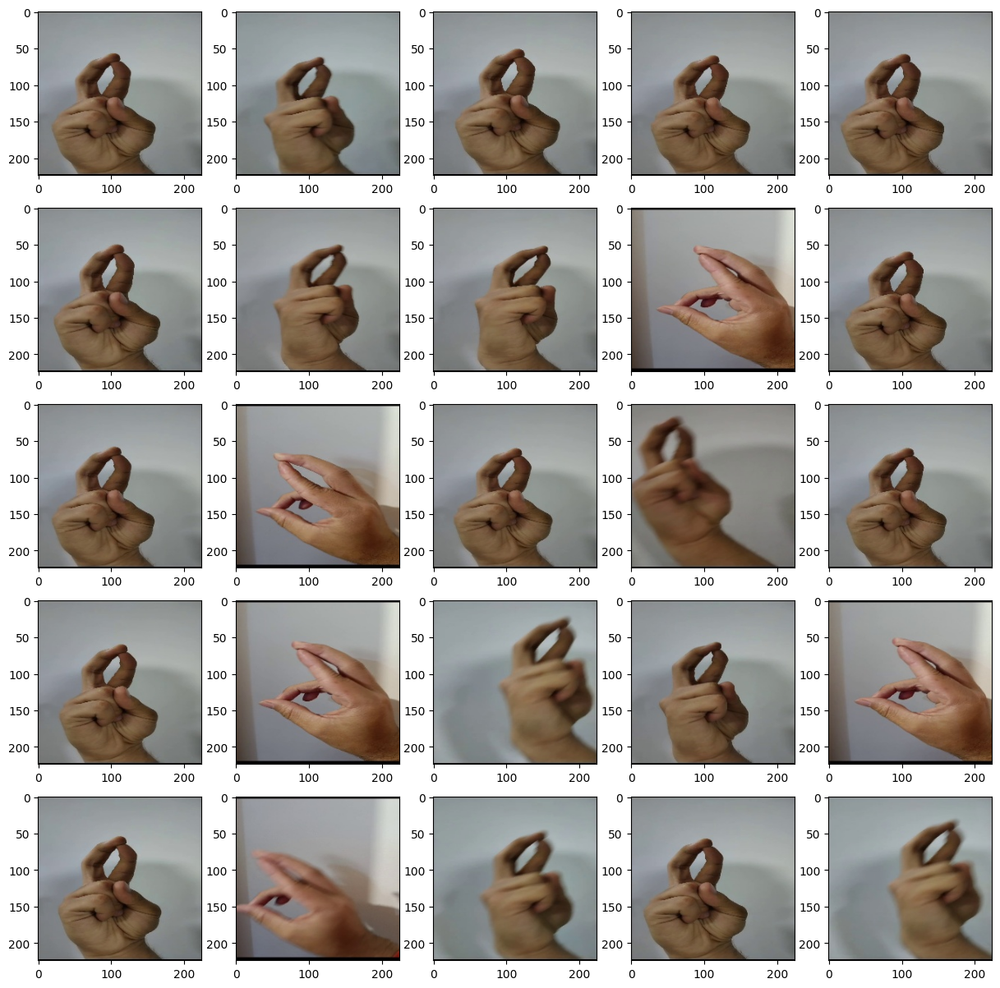

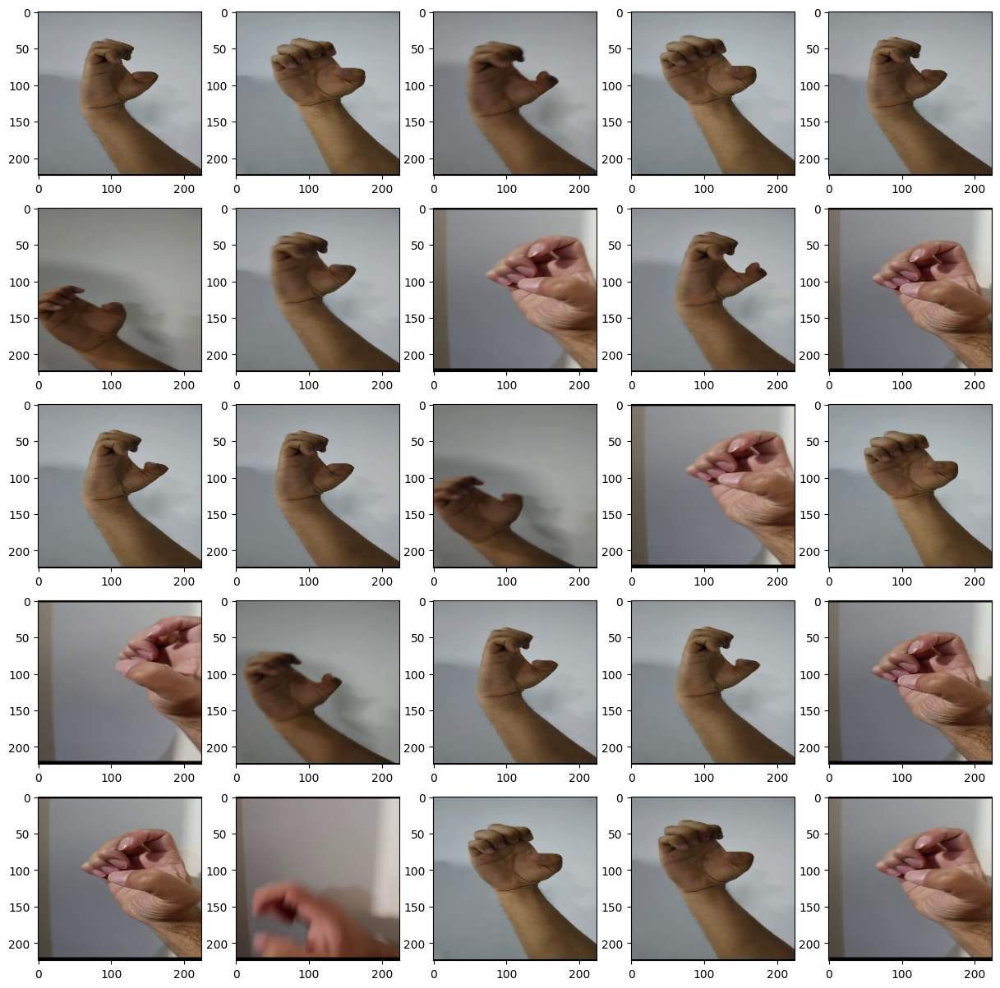

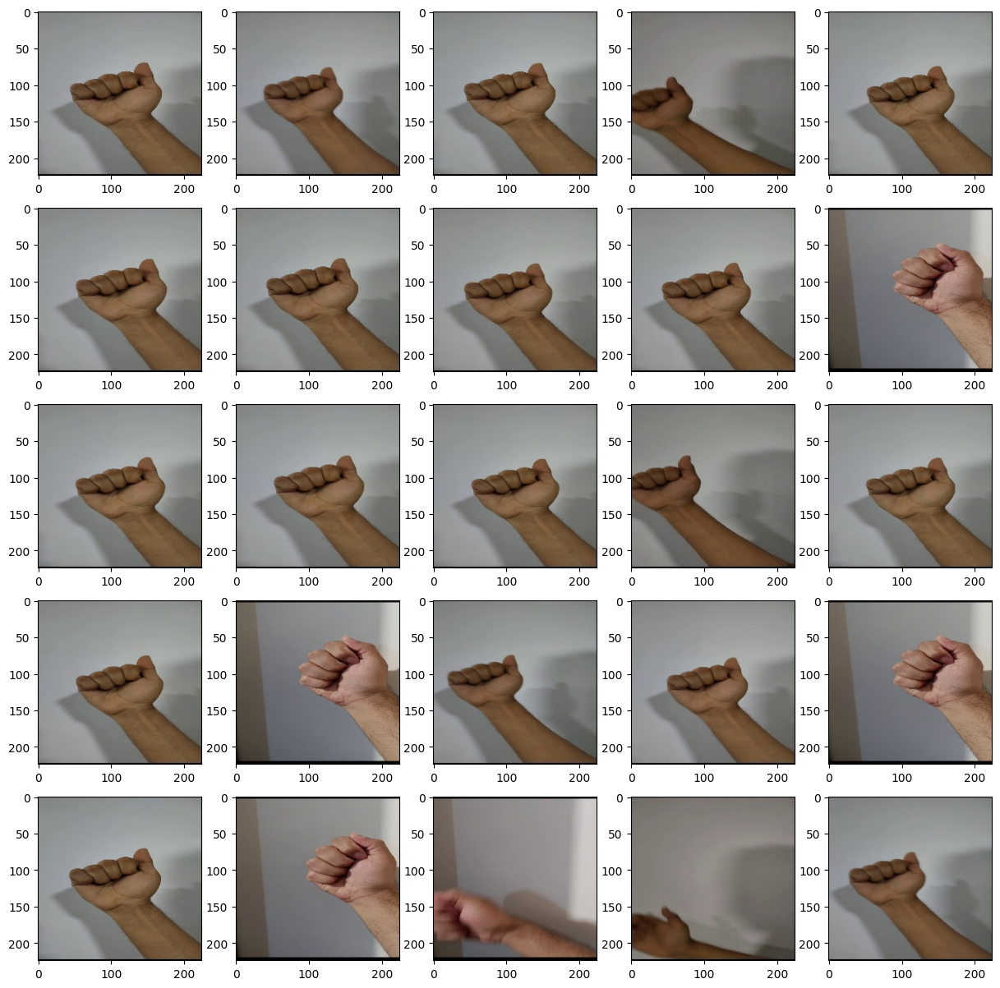

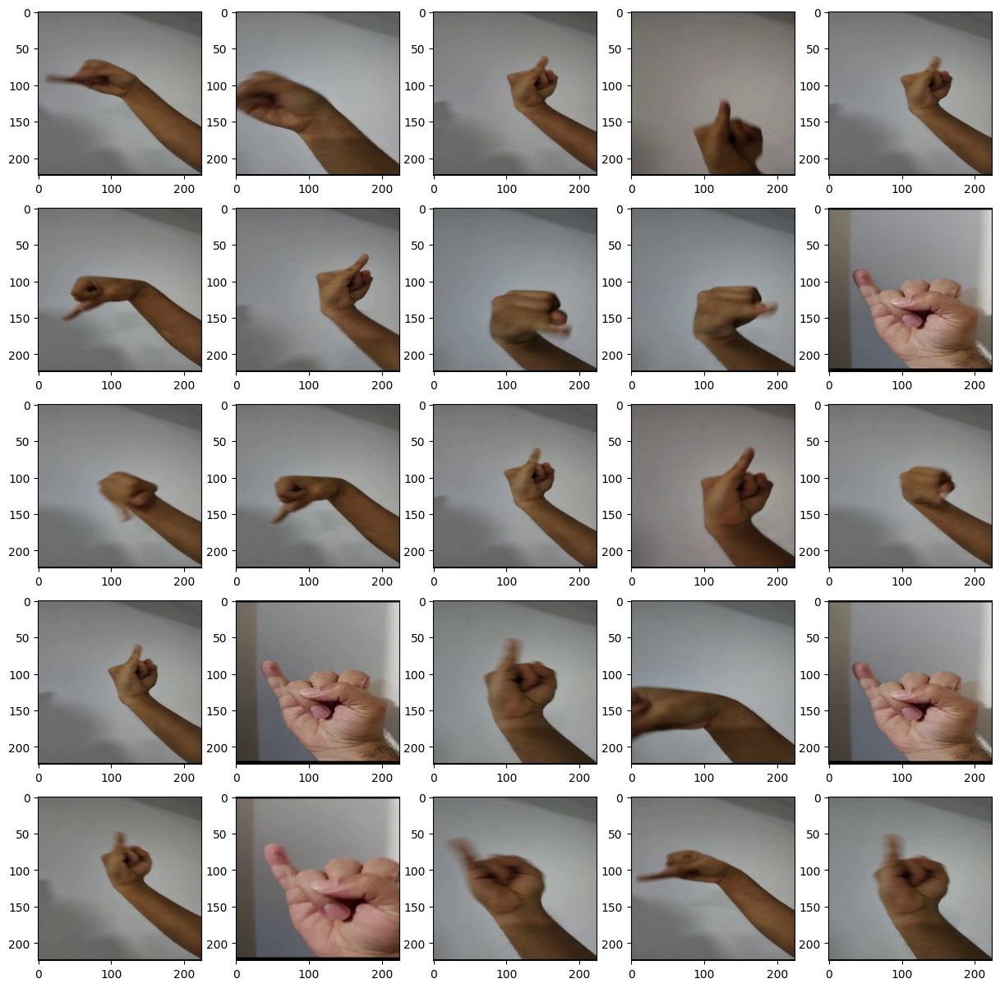

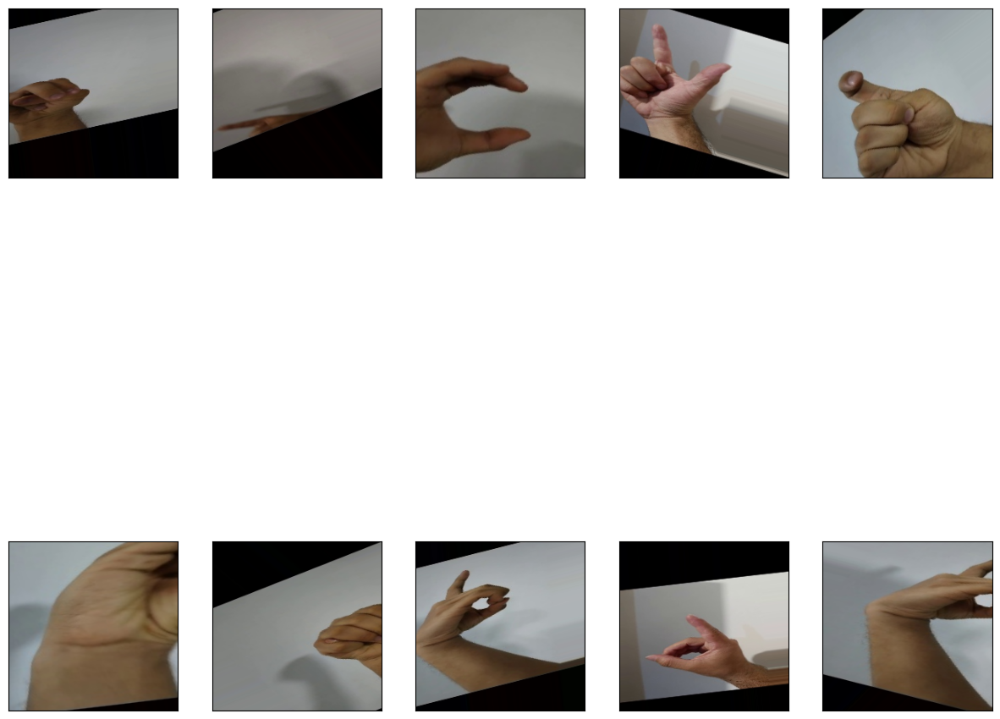

In [1]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil
#Aumento de datos con ImageDataGenerator
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np


def imprimir(nombreCarpeta):

    plt.figure(figsize=(15,15))

    carpeta = 'dataset_temp/'+nombreCarpeta
    imagenes = os.listdir(carpeta)

    for i, nombreimg in enumerate(imagenes[:25]):
        plt.subplot(5,5,i+1)
        imagen = mpimg.imread(carpeta + '/' + nombreimg)
        plt.imshow(imagen)

def enviarDatos(nombreCarpeta):

    carpeta_fuente = 'dataset_temp/'+nombreCarpeta
    carpeta_destino = 'dataset/'+nombreCarpeta
    os.makedirs(carpeta_destino,exist_ok=True)
    imagenes = os.listdir(carpeta_fuente)

    for i, nombreimg in enumerate(imagenes):
        # Verifica si la extensión del archivo es .jpg o .png
        if nombreimg.lower().endswith(('.jpg', '.png')):
            if i < 100:
                # Copia solo las imágenes con extensiones .jpg o .png
                shutil.copy(os.path.join(carpeta_fuente, nombreimg), os.path.join(carpeta_destino, nombreimg))

def contar(nombreCarpeta):
    carpeta='dataset/'+nombreCarpeta
    archivos=os.listdir(carpeta)
    numArchivos=len(archivos)
    print(str(numArchivos)+" archivos de la carpeta "+nombreCarpeta)

def aumentarDataSet():
    #Crear el dataset generador
    datagen = ImageDataGenerator(
        rescale=1. / 255,
        rotation_range = 30,
        width_shift_range = 0.25,
        height_shift_range = 0.25,
        shear_range = 15,
        zoom_range = [0.5, 1.5],
        validation_split=0.2 #20% para pruebas
    )

    #Generadores para sets de entrenamiento y pruebas
    data_gen_entrenamiento = datagen.flow_from_directory(
        'dataset/',
        target_size=(224,224),
        batch_size=32,
        shuffle=True,
        subset='training',
        classes=['a', 'b', 'c', 'd', 'e','eye','f','g','h','i','j','k','l','m','n','o', 'p', 'q', 'r', 's', 't','u', 'v','w','x', 'y','z']
        )
    data_gen_pruebas = datagen.flow_from_directory(
        'dataset/',
        target_size=(224,224),
        batch_size=32,
        shuffle=True,
        subset='validation',
        classes=['a', 'b', 'c', 'd', 'e','eye','f','g','h','i','j','k','l','m','n','o', 'p', 'q', 'r', 's', 't','u', 'v','w','x', 'y','z']
        )


    #Imprimir 10 imagenes del generador de entrenamiento
    for imagen, etiqueta in data_gen_entrenamiento:
        for i in range(10):
            plt.subplot(2,5,i+1)
            plt.xticks([])
            plt.yticks([])
            plt.imshow(imagen[i])
        break
    plt.show()

    return data_gen_entrenamiento, data_gen_pruebas


nombresCarpetas = os.listdir("dataset_temp") #guardar todos los archivos de la carpeta
#print(nombresCarpetas)
for nombreCarpeta in nombresCarpetas: #archivo por archivo
    imprimir(nombreCarpeta)
    #print(nombreCarpeta)
    enviarDatos(nombreCarpeta)
    contar(nombreCarpeta)
data_gen_entrenamiento, data_gen_pruebas = aumentarDataSet()

In [2]:
data_gen_entrenamiento

In [3]:
import tensorflow as tf
import tensorflow_hub as hub

url = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
mobilenetv2 = hub.KerasLayer(url, input_shape=(224,224,3))

In [4]:
#Congelar el modelo descargado
mobilenetv2.trainable = False

In [5]:
modelo = tf.keras.Sequential([
    mobilenetv2,
    tf.keras.layers.Dense(27, activation='softmax')
])

In [6]:
modelo.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 27)                34587     
                                                                 
Total params: 2292571 (8.75 MB)
Trainable params: 34587 (135.11 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [7]:
#Compilar como siempre
modelo.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [8]:
#Entrenar el modelo
EPOCAS = 50

historial = modelo.fit(
    data_gen_entrenamiento,
    epochs=EPOCAS,
    batch_size=32,
    validation_data=data_gen_pruebas
)

Epoch 1/50
68/68 [==============================] - 135s 2s/step - loss: 2.5957 - accuracy: 0.3157 - val_loss: 3.0267 - val_accuracy: 0.1167
Epoch 2/50
68/68 [==============================] - 143s 2s/step - loss: 1.4906 - accuracy: 0.6616 - val_loss: 2.7497 - val_accuracy: 0.1926
Epoch 3/50
68/68 [==============================] - 159s 2s/step - loss: 1.0607 - accuracy: 0.7630 - val_loss: 2.4704 - val_accuracy: 0.3148
Epoch 4/50
68/68 [==============================] - 146s 2s/step - loss: 0.8927 - accuracy: 0.8000 - val_loss: 2.4747 - val_accuracy: 0.3241
Epoch 5/50
68/68 [==============================] - 145s 2s/step - loss: 0.7503 - accuracy: 0.8218 - val_loss: 2.4163 - val_accuracy: 0.3148
Epoch 6/50
68/68 [==============================] - 125s 2s/step - loss: 0.6794 - accuracy: 0.8301 - val_loss: 2.1989 - val_accuracy: 0.3796
Epoch 7/50
68/68 [==============================] - 143s 2s/step - loss: 0.6011 - accuracy: 0.8606 - val_loss: 2.0799 - val_accuracy: 0.4185
Epoch 8/50
68

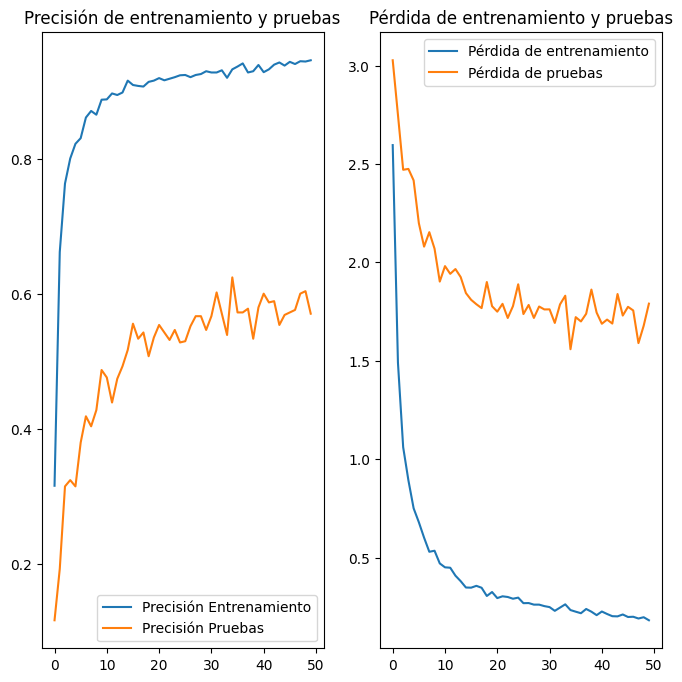

In [9]:
#Graficas de precisión
acc = historial.history['accuracy']
val_acc = historial.history['val_accuracy']

loss = historial.history['loss']
val_loss = historial.history['val_loss']

rango_epocas = range(50)

plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(rango_epocas, acc, label='Precisión Entrenamiento')
plt.plot(rango_epocas, val_acc, label='Precisión Pruebas')
plt.legend(loc='lower right')
plt.title('Precisión de entrenamiento y pruebas')

plt.subplot(1,2,2)
plt.plot(rango_epocas, loss, label='Pérdida de entrenamiento')
plt.plot(rango_epocas, val_loss, label='Pérdida de pruebas')
plt.legend(loc='upper right')
plt.title('Pérdida de entrenamiento y pruebas')
plt.show()

In [10]:
#Categorizar una imagen de internet
from PIL import Image
import requests
from io import BytesIO
import cv2

def categorizar(url):
  respuesta = requests.get(url)
  img = Image.open(BytesIO(respuesta.content))
  img = np.array(img).astype(float)/255

  img = cv2.resize(img, (224,224))
  prediccion = modelo.predict(img.reshape(-1, 224, 224, 3))
  print(prediccion)
  return np.argmax(prediccion[0], axis=-1), prediccion

In [11]:
url = 'https://previews.123rf.com/images/darakchi/darakchi1610/darakchi161000002/67248782-letra-b-en-lenguaje-de-se%C3%B1as-americano-asl-para-personas-sordas.jpg' #debe ser 1
prediccion, full  = categorizar (url)
print(prediccion)

1/1 [==============================] - 1s 572ms/step
[[2.7858669e-02 9.4798142e-01 5.6588220e-08 9.1205557e-06 3.4163211e-05
  3.9597262e-07 7.7619341e-05 2.7116715e-07 5.4259873e-03 1.3246276e-02
  3.2926444e-04 1.3569451e-03 4.4510571e-06 6.8927948e-06 6.4140255e-07
  5.0777721e-06 5.6524196e-10 2.8428988e-04 5.3660900e-05 4.0250183e-05
  5.8470559e-06 5.0717688e-07 1.4709109e-04 9.4372326e-06 4.1428575e-05
  5.7433466e-05 3.0228088e-03]]
1


In [12]:
modelo.save('mm/modelo_entrenado.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
